Minimal implementation of Particle-in-Cell method for plasma simulation

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.constants import epsilon_0, e, m_e, m_p
from sklearn.neighbors import KernelDensity

In [2]:
class Particles:
    def __init__(self, n, q, m):
        self.data = np.zeros(n, dtype={"names": ("x", "vx", "E"), "formats": ["f8"]*5})
        self.q = q
        self.m = m

In [3]:
def sample_nearest(x, nx, dx):
    return np.histogram(x, bins=(np.arange(nx+1)-0.5)*dx)[0]

In [4]:
def sample_linear(x, nx, dx):
    x[x==(nx-1)*dx] = 0.
    rho = np.zeros(nx)
    xi = x/dx
    xl = xi.astype(int)
    w = xi - xl
    np.add.at(rho, xl, 1-w)
    np.add.at(rho, xl+1, w)
    rho[0] += rho[-1] # periodic bc
    rho[-1] = rho[0]
    return rho

In [5]:
def differentiate_periodic(U, dx):
    E = np.r_[U[1]-U[-2], U[2:] - U[:-2], U[1]-U[-2]]/dx
    return E

In [6]:
from scipy.fftpack import fft, ifft, fftfreq
def fft_solve_periodic(rho, nx, xmax, dx):
    rho = rho.copy()
    rho_k = fft(rho[:-1])
    kx = fftfreq(nx-1)/dx
    lambda_k = -(kx*2*np.pi/xmax)**2 * np.sinc(kx/(nx-1))**2
    U_k = np.r_[0, -rho_k[1:]/epsilon_0/lambda_k[1:]] # set zeroth component to zero
    U = ifft(U_k).real
    return np.r_[U, U[0]] # periodic BC

In [7]:
def interpolate_nearest(x, field):
    from scipy.interpolate import interp1d
    return interp1d(x, field, kind="nearest")
def interpolate_linear(x, field):
    from scipy.interpolate import interp1d
    return interp1d(x, field, kind="linear")

In [8]:
def advance(particles, E, dt):
    particles.data["vx"] += particles.data["E"]*particles.q/particles.m * dt
    particles.data["x"] += particles.data["vx"] * dt

def advance_v(particles, E, dt):
    particles.data["vx"] += particles.data["E"]*particles.q/particles.m * dt

In [9]:
def particle_bc(particles, xmax):
    while particles.data["x"].max() >= xmax:
        particles.data["x"][ particles.data["x"] >= xmax ] -= xmax
    while particles.data["x"].min() < 0:
        particles.data["x"][ particles.data["x"] < 0 ] += xmax

In [10]:
class PIC:
    def __init__(self, particles, nx, xmax, dV=1):
        self.particles = particles
        
        self.nx = nx
        self.xmax = xmax
        self.dx = xmax/(nx-1)
        self.x = np.linspace(0, xmax, nx)
        self.xbins = (np.arange(nx+1)-0.5)*self.dx
        
        self.dV = dV
        
        self.rho = np.zeros(nx)
        self.U = np.zeros(nx)
        self.E = np.zeros(nx)
        
        self.rhobg = 0.
        
    def sample(self):
        self.rho = self.rhobg
        for p in self.particles: self.rho += sample_linear(p.data["x"], self.nx, self.dx)*p.q/self.dV
            
    def poisson_solve(self):
        self.U = fft_solve_periodic(self.rho, self.nx, self.xmax, self.dx)
        self.E = -differentiate_periodic(self.U, self.dx)
        
    def interpolate(self):
        Eint = interpolate_linear(self.x, self.E)
        for p in particles:
            p.data["E"] = Eint(p.data["x"])
            
    def advance(self, dt):
        for p in particles:
            advance(p, self.E, dt)
            particle_bc(p, self.xmax)
    
    def init_leapfrog(self, dt):
        # move velocities to -dt/2 to start the leap frog integration
        self.sample()
        self.poisson_solve()
        self.interpolate()
        for p in self.particles:
            advance_v(p, self.E, -dt/2)
            particle_bc(p, self.xmax)

In [11]:
class Diagnostic:
    def __init__(self, nx, nv, nt, xmax, vmax, tmax):
        self.nt = nt
        self.nv = nv
        self.nx = nx
        
        self.ts = np.zeros(nt)
        self.rhos = np.zeros((nt, nx))
        self.Us = np.zeros((nt, nx))
        self.Es = np.zeros((nt, nx))
        self.vs = np.zeros((nt, nv))
        self.PSs = np.zeros((nt, nx, nv))
        
        self.xmax = xmax
        self.vmax = vmax
        self.tmax = tmax
        dv = 2*vmax/(nv-1)
        self.vbins = np.linspace(-vmax-dv/2, vmax+dv/2, nv+1)

        self.N = 0

    def sample(self, t, pic):
        for p in pic.particles:
            self.vs[self.N] += np.histogram(p.data["vx"], bins=self.vbins)[0]*p.q
            self.PSs[self.N] += np.histogram2d(p.data["x"], p.data["vx"],
                                          bins=(pic.xbins, self.vbins))[0]*p.q
        self.Us[self.N] = pic.U
        self.Es[self.N] = pic.E
        self.rhos[self.N] = pic.rho
        self.ts[self.N] = t
        
        self.N += 1
        
    def plot(self):
        f, (ax1, ax2, ax3, ax4) = plt.subplots(1,4,figsize=(15, 5))
        def plot_record(F, ax, extent = (0, self.xmax, self.tmax, 0)):
            ax.imshow(F, cmap=plt.get_cmap("bwr"), extent=extent,
                      vmin = min(F.min(), -F.max()), vmax = max(F.max(), -F.min()),
                     aspect="auto")
        plot_record(self.rhos, ax1)
        plot_record(self.Us, ax2)
        plot_record(self.Es, ax3)
        plot_record(self.vs, ax4, extent = (-self.vmax, self.vmax, self.tmax, 0))
        
    def plot_PS(self, lims=1e-18):
        f, (ax1) = plt.subplots(1,1,figsize=(5, 5))
        ax1.imshow(self.PSs.sum(axis=0).T, vmin=-lims, vmax=lims, cmap=plt.get_cmap("bwr"))

In [12]:
nx = 101
xmax = 1
nv = 101
vmax = 10
dt = 0.01
dV = 1
tmax = 1
ntmax = int(np.ceil(tmax/dt))

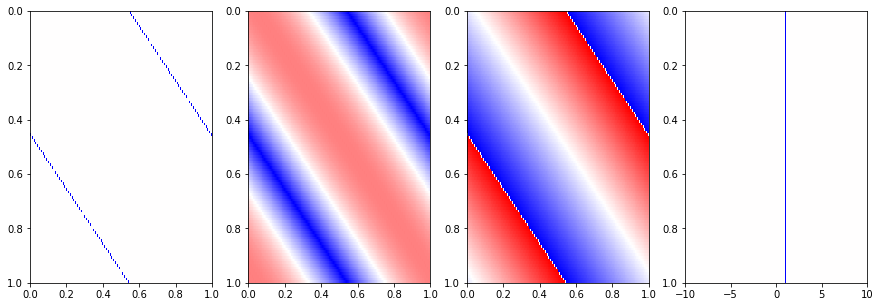

In [13]:
nx = 201
xmax = 1
nv = 201
vmax = 10
dt = 0.01
dV = 1
tmax = 1
ntmax = int(np.ceil(tmax/dt))

electrons = Particles(1, -e, m_e)
particles = [electrons]
electrons.data["x"] = 0.55
electrons.data["vx"] = 1

pic = PIC(particles, nx, xmax)
pic.rhobg = e/nx/dV

pic.init_leapfrog(dt)

diag = Diagnostic(nx, nv, ntmax, xmax, vmax, dt*ntmax)

for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

diag.plot()

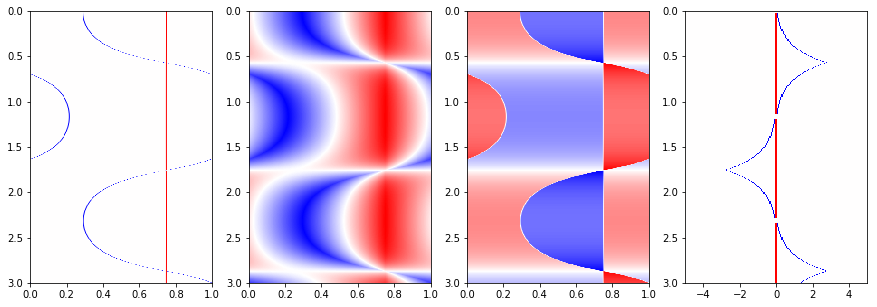

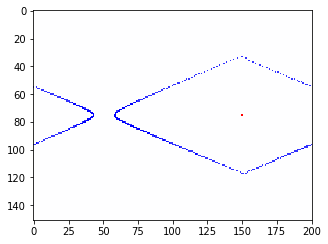

In [14]:
nx = 201
xmax = 1
nv = 151
vmax = 5
dt = 0.005
dV = 1
tmax = 3
ntmax = int(np.ceil(tmax/dt))

electrons = Particles(1, -e, m_e)
protons = Particles(1, e, m_p)
particles = [electrons, protons]
protons.data["x"] = 0.75
electrons.data["x"] = 0.29

pic = PIC(particles, nx, xmax, dV)
pic.init_leapfrog(dt)

diag = Diagnostic(nx, nv, ntmax, xmax, vmax, dt*ntmax)

for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

diag.plot()
diag.plot_PS(lims=2e-19)

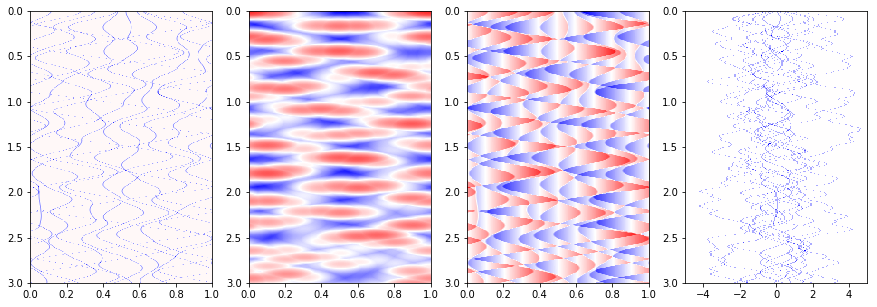

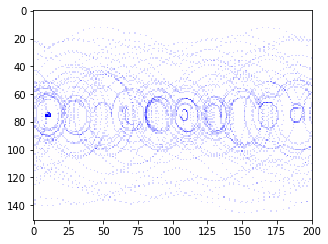

In [15]:
nx = 201
xmax = 1
nv = 151
vmax = 5
dt = 0.005
dV = 1
tmax = 3
ntmax = int(np.ceil(tmax/dt))
ne = 10

electrons = Particles(ne, -e, m_e)
particles = [electrons]
electrons.data["x"] = np.random.uniform(0, xmax, ne)
electrons.data["vx"] = 0.005

pic = PIC(particles, nx, xmax)
pic.rhobg = ne*e/nx/dV

pic.init_leapfrog(dt)

diag = Diagnostic(nx, nv, ntmax, xmax, vmax, dt*ntmax)

for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

diag.plot()
diag.plot_PS()

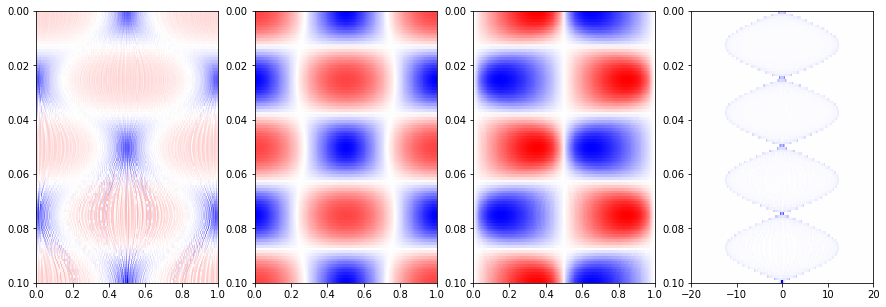

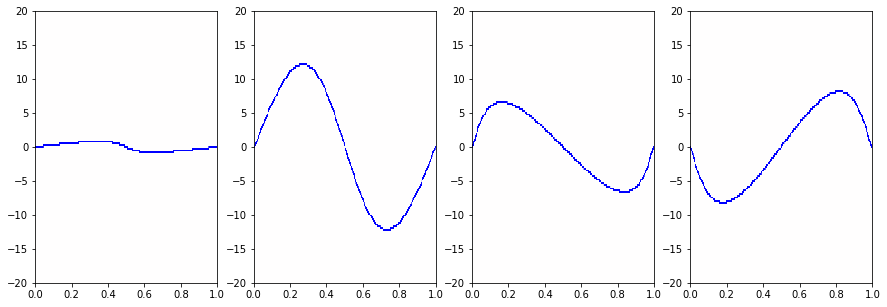

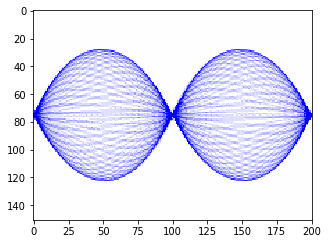

In [16]:
ne = 10000
nx = 201
xmax = 1
nv = 151
vmax = 20
dt = 0.001
dV = 20
tmax = 0.1
ntmax = int(np.ceil(tmax/dt))
exc = 0.1

electrons = Particles(ne, -e, m_e)
particles = [electrons]
#electrons.data["x"] = np.random.uniform(0, xmax, ne)
electrons.data["x"] = np.arange(ne)*xmax/ne
electrons.data["x"] += exc*np.sin(electrons.data["x"]/xmax*2*np.pi) + np.random.normal(0, 1e-3, ne)
particle_bc(electrons, xmax)

pic = PIC(particles, nx, xmax, dV)
pic.rhobg = ne*e/nx/dV

pic.init_leapfrog(dt)

diag = Diagnostic(nx, nv, ntmax, xmax, vmax, dt*ntmax)

for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

diag.plot()
f, axs = plt.subplots(1,4,figsize=(15, 5))
for ax, t in zip(axs, [0, 10, 20, 30]):
    ax.imshow(diag.PSs[t].T, vmin=-1e-18, vmax=1e-18, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])
diag.plot_PS(lims=5e-17)

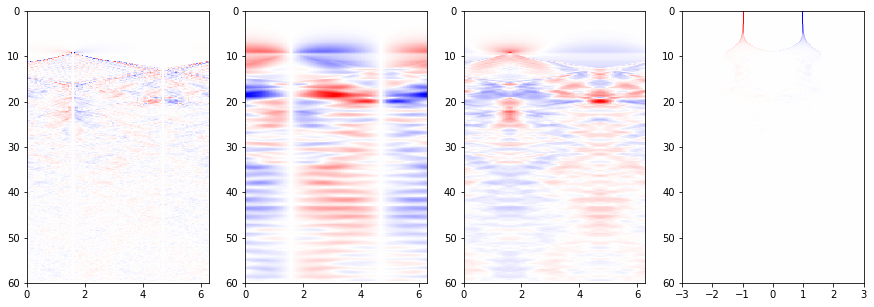

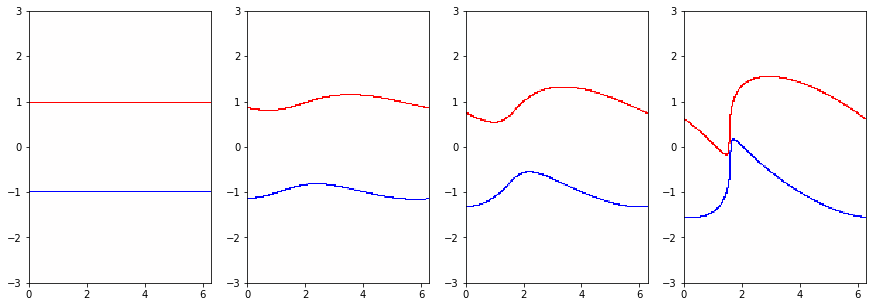

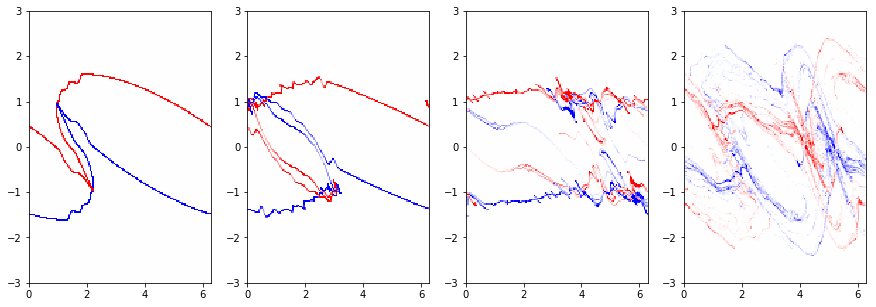

In [17]:
ne = 4096*4
nx = 32*4+1
xmax = 2*np.pi
nv = 201
vmax = 3
dt = 0.2
dV = 1
tmax = dt*300
epsilon_0 = 1
WP = 1
QM = 1
Q = WP**2*xmax/ne*1/(epsilon_0*QM)
v0 = 1
exc = 0.001

electrons = Particles(ne, -Q, Q/QM)
positrons = Particles(ne, Q, Q/QM)
electrons.data["x"] = np.arange(ne)*xmax/ne
electrons.data["x"] += exc*np.cos(2*np.pi*electrons.data["x"]/xmax)
electrons.data["vx"] = v0
positrons.data["x"] = np.arange(ne)*xmax/ne
positrons.data["x"] += exc*np.cos(2*np.pi*positrons.data["x"]/xmax)
positrons.data["vx"] = -v0
particle_bc(electrons, xmax)
particle_bc(positrons, xmax)

particles = [electrons, positrons]

pic = PIC(particles, nx, xmax, dV)

ntmax = int(np.ceil(tmax/dt))
diag = Diagnostic(nx, nv, ntmax+2, xmax, vmax, dt*ntmax)


pic.init_leapfrog(dt)
for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

diag.plot()
f, axs = plt.subplots(1,4,figsize=(15, 5))
for ax, t in zip(axs, [10, 35, 40, 45]):
    ax.imshow(diag.PSs[t].T, vmin=-1e-2, vmax=1e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])
f, axs = plt.subplots(1,4,figsize=(15, 5))
for ax, t in zip(axs, [50, 55, 70, 100]):
    ax.imshow(diag.PSs[t].T, vmin=-1e-2, vmax=1e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])

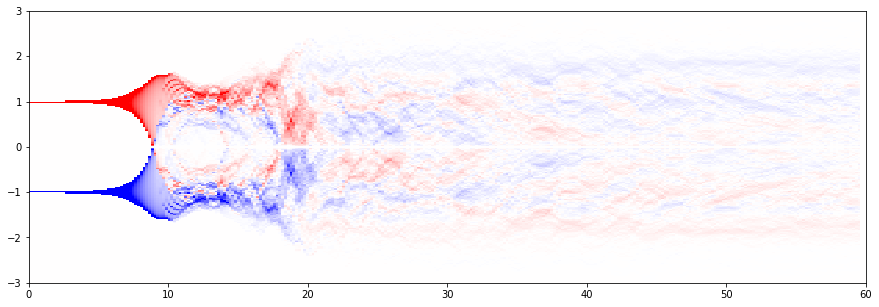

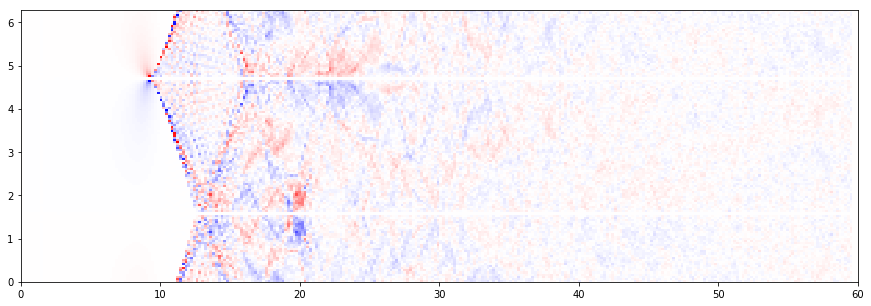

In [18]:
f, axs = plt.subplots(1,1,figsize=(15, 5))
axs.imshow(diag.vs.T, vmin=-.3, vmax=.3, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, tmax, -vmax, vmax])
f, axs = plt.subplots(1,1,figsize=(15, 5))
axs.imshow(diag.rhos.T, vmin=-.2, vmax=.2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, tmax, 0, xmax])

In [19]:
from matplotlib import animation
from IPython.display import HTML

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))
kwargs = dict(vmin=-1e-2, vmax=1e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])
plt.close()
im = ax1.imshow(diag.PSs[0].T, **kwargs)
dist, = ax2.plot(diag.PSs[0].sum(axis=0), np.linspace(-vmax, vmax, nv))
def animate(i):
    im.set_array(diag.PSs[i].T)
    dist.set_xdata(diag.PSs[i].sum(axis=0))
    norm = diag.PSs[i].sum(axis=0).max()*2.5
    ax2.set_xlim(-norm, norm)
    return [im, dist]
anim = animation.FuncAnimation(fig, animate, frames=range(300), interval=50)
HTML(anim.to_jshtml())

In [20]:
ne = 4096*4
nx = 32*4+1
xmax = 2*np.pi
nv = 201
vmax = 5
dt = 0.1
dV = 1
tmax = dt*300
epsilon_0 = 1
WP = 1
QM = 1
Q = WP**2*xmax/ne*1/(epsilon_0*QM)
v0 = 1
exc = 0.001

electrons1 = Particles(ne, -Q, Q/QM)
electrons2 = Particles(ne, -Q, Q/QM)
electrons1.data["x"] = np.arange(ne)*xmax/ne
electrons1.data["x"] += exc*np.sin(2*np.pi*electrons1.data["x"]/xmax)
electrons1.data["vx"] = v0
electrons2.data["x"] = np.arange(ne)*xmax/ne
electrons2.data["x"] += exc*np.sin(2*np.pi*electrons2.data["x"]/xmax)
electrons2.data["vx"] = -v0

particle_bc(electrons1, xmax)
particle_bc(electrons2, xmax)
particles = [electrons1, electrons2]

pic = PIC(particles, nx, xmax, dV)
pic.rhobg = 2*ne*Q/(nx-1)/dV

ntmax = int(np.ceil(tmax/dt))
diag = Diagnostic(nx, nv, ntmax+2, xmax, vmax, dt*ntmax)

pic.init_leapfrog(dt)
for nt in range(ntmax):
    pic.sample()
    pic.poisson_solve()
    pic.interpolate()
    pic.advance(dt)
    
    diag.sample(nt*dt, pic)

(302, 129, 201)


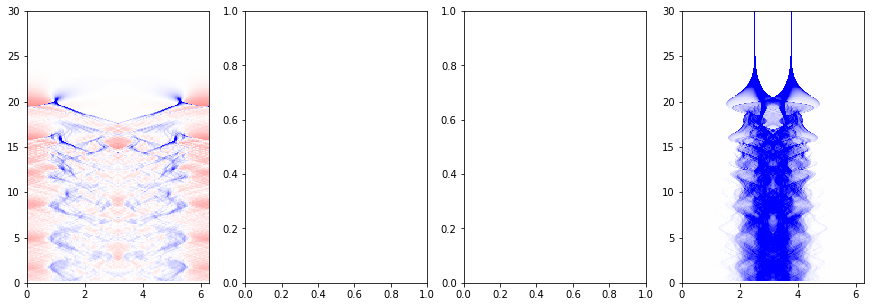

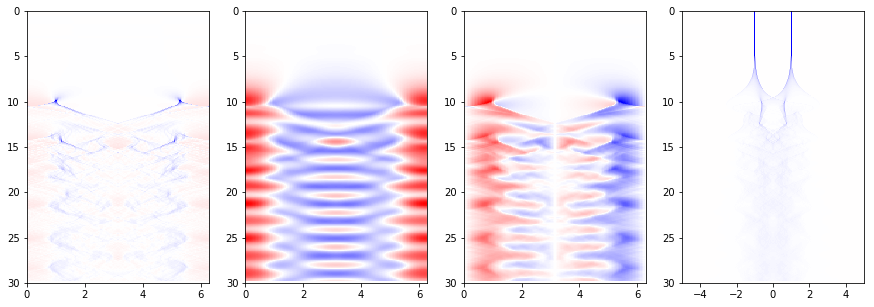

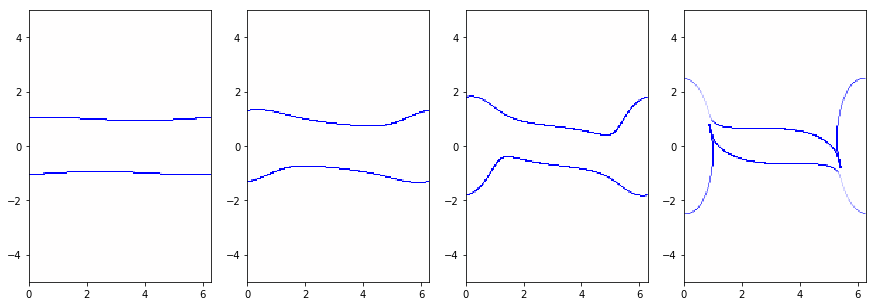

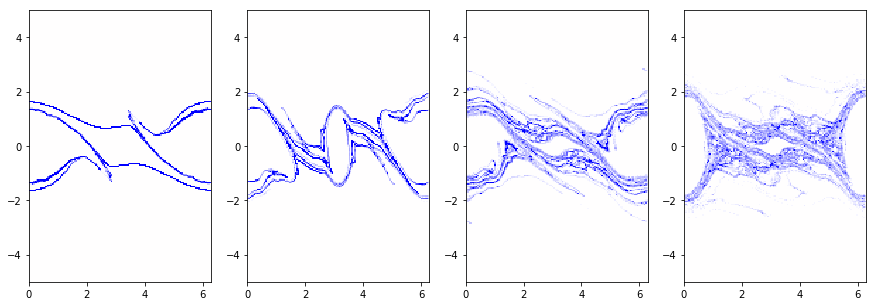

In [21]:
f, axs = plt.subplots(1,4,figsize=(15, 5))
axs[0].imshow(diag.rhos, vmin=-.2, vmax=.2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, 0, tmax])
axs[3].imshow(diag.vs, vmin=-.2, vmax=.2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, 0, tmax])
diag.plot()
print(diag.PSs.shape)
f, axs = plt.subplots(1,4,figsize=(15, 5))
for ax, t in zip(axs, [60, 80, 90, 100]):
    ax.imshow(diag.PSs[t].T, vmin=-2e-2, vmax=2e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])
f, axs = plt.subplots(1,4,figsize=(15, 5))
for ax, t in zip(axs, [120, 150, 200, 250]):
    ax.imshow(diag.PSs[t].T, vmin=-1e-2, vmax=1e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])

In [22]:
from matplotlib import animation
from IPython.display import HTML

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,6))
kwargs = dict(vmin=-1e-2, vmax=1e-2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, xmax, -vmax, vmax])
plt.close()
im = ax1.imshow(diag.PSs[0].T, **kwargs)
dist, = ax2.plot(diag.PSs[0].sum(axis=0), np.linspace(-vmax, vmax, nv))
def animate(i):
    im.set_array(diag.PSs[i].T)
    dist.set_xdata(diag.PSs[i].sum(axis=0))
    norm = diag.PSs[i].sum(axis=0).min()*1.5
    ax2.set_xlim(-norm, norm)
    return [im, dist]
anim = animation.FuncAnimation(fig, animate, frames=range(300), interval=50)
HTML(anim.to_jshtml())

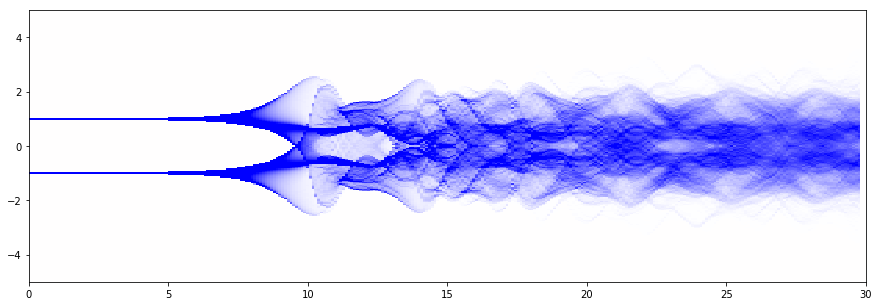

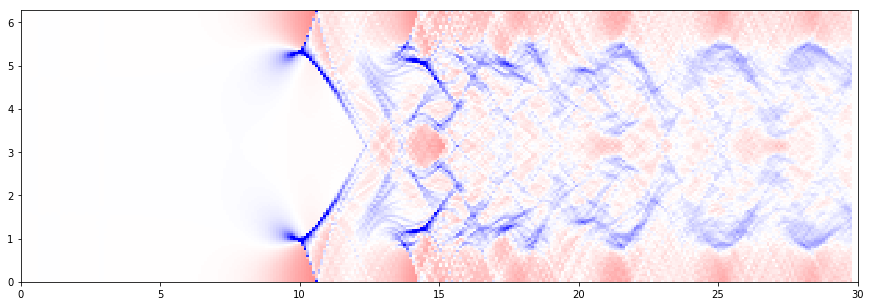

In [23]:
f, axs = plt.subplots(1,1,figsize=(15, 5))
axs.imshow(diag.vs.T, vmin=-.3, vmax=.3, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, tmax, -vmax, vmax])
f, axs = plt.subplots(1,1,figsize=(15, 5))
axs.imshow(diag.rhos.T, vmin=-.2, vmax=.2, cmap=plt.get_cmap("bwr"), aspect="auto",
             extent=[0, tmax, 0, xmax])